**C7082- Techniques in Machine learning and AI**

**Student id 22358100**


**Github link**

https://github.com/satyaandrew/C7082-Techniques-in-ML-AI.git

**Background**

The motivation behind creating a rice disease dataset is to help diagnose and manage rice plant diseases, which can significantly impact crop yields and food security. Research in this area is motivated by the need to develop effective and efficient methods for early disease detection and diagnosis, which can inform the implementation of preventive measures to reduce the spread of diseases and improve crop health.
Training a plant disease dataset in rice can serve the following objectives:
Early Detection: By training a model on a rice plant disease dataset, one can detect and diagnose the disease at an early stage, which is crucial for prompt treatment and prevention of further spread.
Improved Farming Practices: With a well-trained model, farmers can monitor the health of their crops, identify signs of disease and take preventive measures, leading to improved crop yields and better-quality produce.
Research and Development: A trained model can also be used in research and development to understand the factors that contribute to the spread of diseases in rice crops, which can inform new and better ways to prevent and manage diseases.
 Automation: Training a model on a rice disease dataset can also help automate the diagnosis and treatment process, reducing the time and resources required, and improving the accuracy of disease identification.


**Data Source**
https://universe.roboflow.com/class2-a0z5r/dou

**Methods**

The rice disease dataset is a collection of images of rice plants from different rice crops at different stages of growth, and under different environmental conditions. The purpose of the dataset is to provide a comprehensive and representative set of data for training machine learning models to accurately detect and classify different types of rice plant diseases.
YOLO (You Only Look Once) v5 is a popular object detection model that can be used for rice plant disease detection. YOLO is a convolutional neural network (CNN) that has been trained to perform object detection by identifying and classifying objects within images.
Roboflow was used to manage and pre-process the rice disease dataset, including annotating and labelling the images. YOLO v5, a popular object detection model, was then trained on the processed data using Google Colab, an online platform for developing and running machine learning models. The trained YOLO v5 model was used to detect and classify different types of rice plant diseases in images.


In [27]:
#the starting step is to mount a Google Drive directory to Google Colab environment
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 15074, done.
remote: Counting objects: 100% (55/55), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 15074 (delta 26), reused 29 (delta 13), pack-reused 15019
Receiving objects: 100% (15074/15074), 14.14 MiB | 31.28 MiB/s, done.
Resolving deltas: 100% (10325/10325), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 43.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.0/49.0 KB 4.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 17.7 MB/s eta 0:00:00
Setup complete. Using torch 1.13.1

In [3]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [4]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [5]:
# import the Roboflow library and create an instance of the Roboflow class with the provided API key.
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="pvJA1jMv5ijFN5GAIjow")
project = rf.workspace().project("assignment-iawbv")
dataset = project.version(1).download("yolov5")


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/assignment-1 in yolov5pytorch:: 100%|██████████| 4504/4504 [00:01<00:00, 2481.51it/s]


In [17]:
# train the model
!python train.py --img 416 --batch 16 --epochs 200 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/assignment-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-82-gcec1b9b Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0

In [23]:
# Start tensorboard
# Launch after you have started training 
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 54766), started 0:09:17 ago. (Use '!kill 54766' to kill it.)

<IPython.core.display.Javascript object>

In [24]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/assignment-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-82-gcec1b9b Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/225 /content/datasets/assignment-1/test/images/blasst-122-_jpg.rf.5fe265db80b2a969cf0a73aa93a45314.jpg: 416x416 5 diseases, 8.1ms
image 2/225 /content/datasets/assignment-1/test/images/blasst-155-_jpg.rf.87ab20321a49613faf488f640869b05e.jpg: 416x416 5 diseases, 8.1ms
image 3/225 /content/datasets/assignment-1/test/i

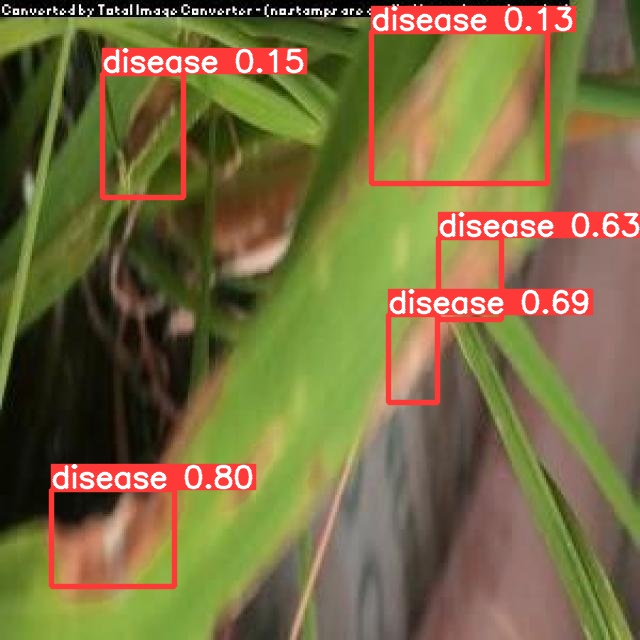

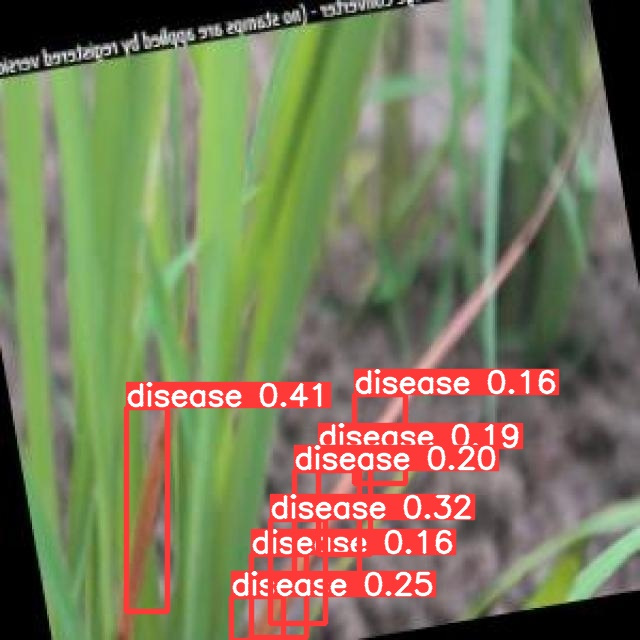

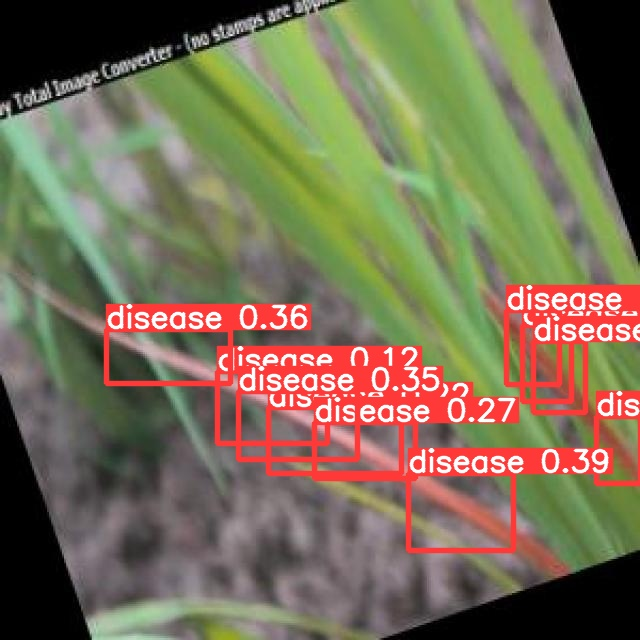

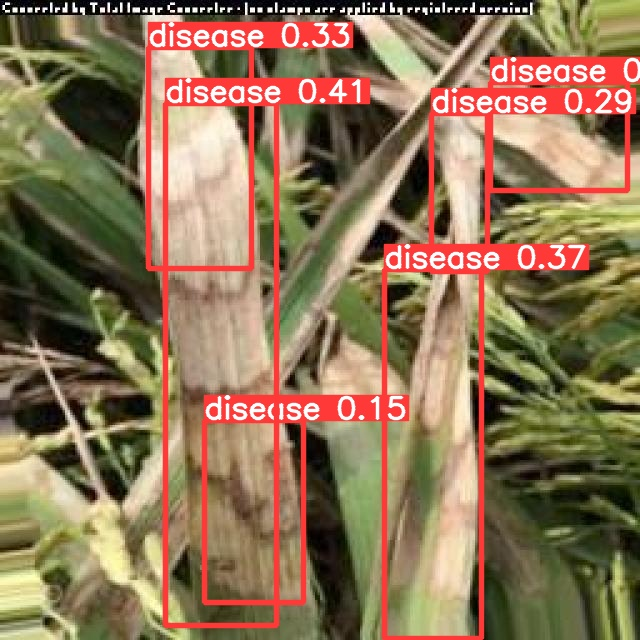

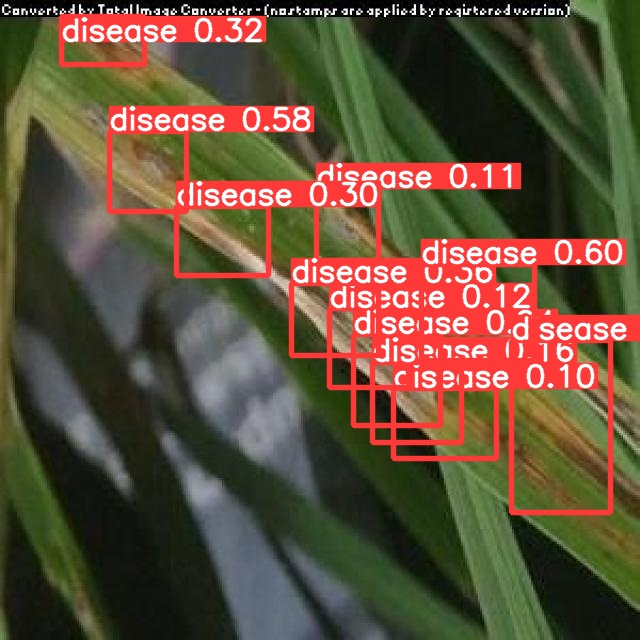

...

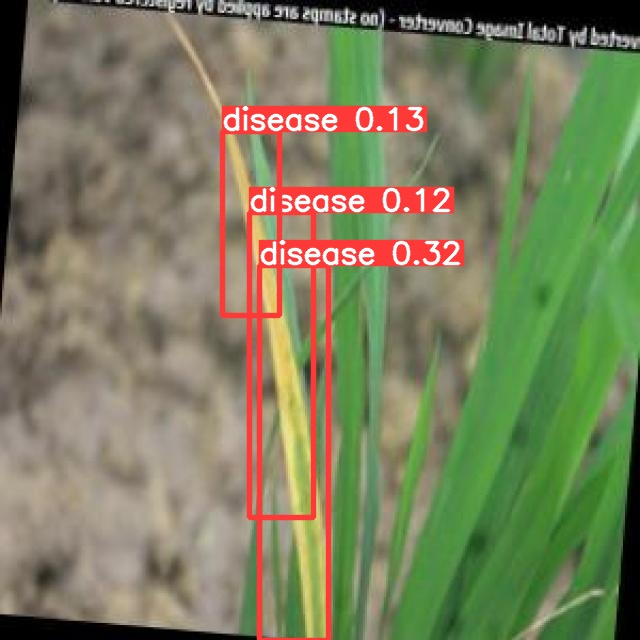

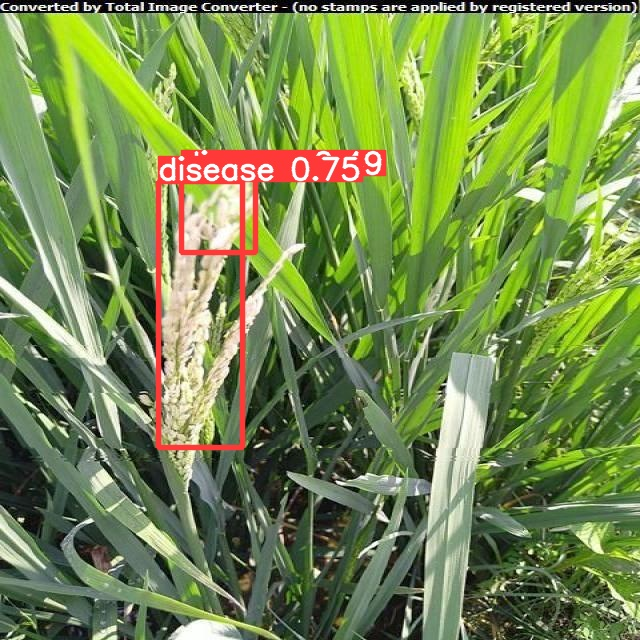

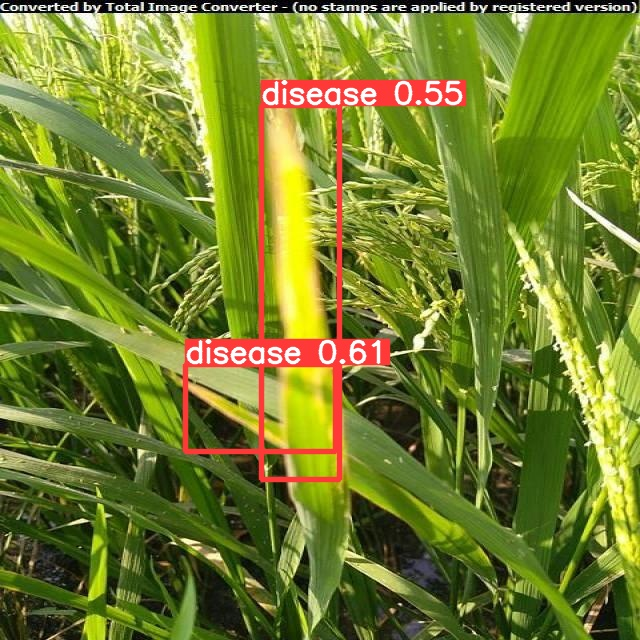

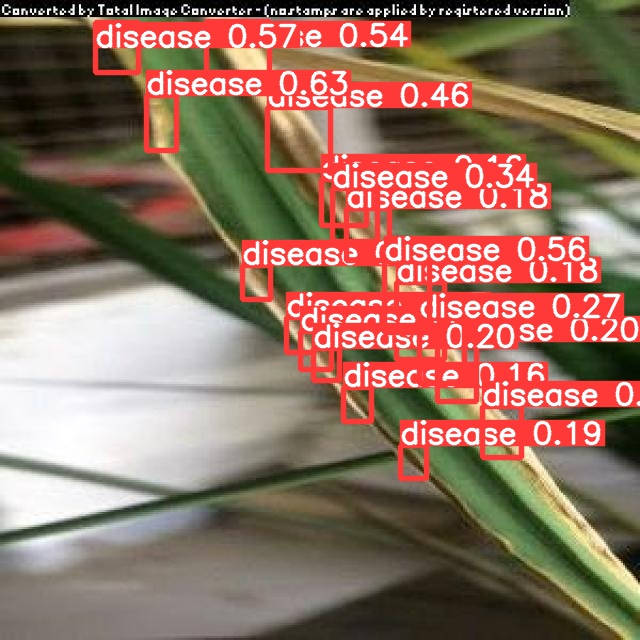

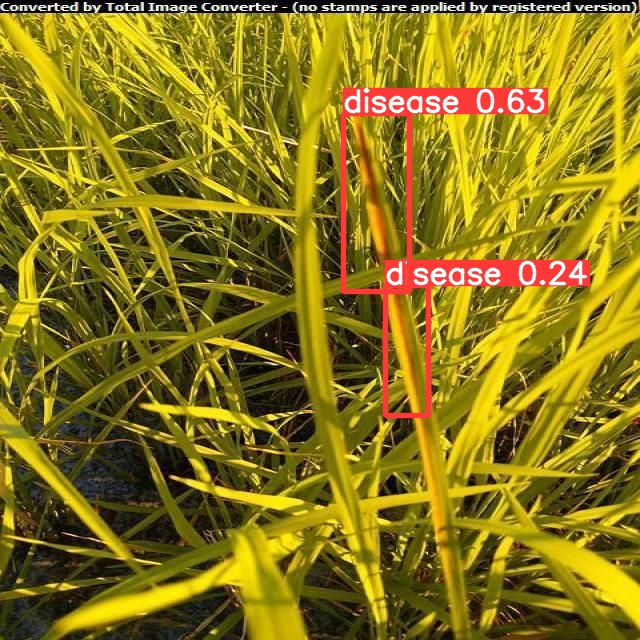

In [25]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

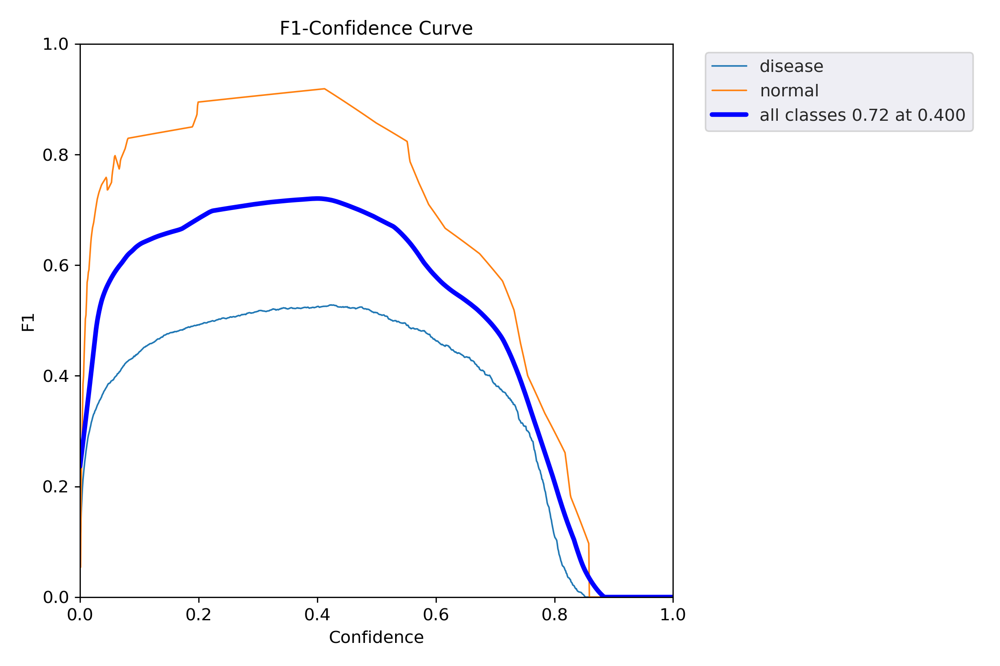

In [21]:
from IPython.display import Image, display
display(Image('/content/yolov5/runs/train/exp/F1_curve.png'))

The F1 score is a measure of the accuracy of a classifier that takes both precision and recall into account.The F1 confidence curve for "disease," "normal," and "all classes" shows that the F1 score reaches its maximum value of 0.72 at a confidence threshold of 0.400. This means that the classifier is most accurate when the confidence threshold is set to 0.400. At this threshold, the classifier has a F1 score of 0.72, which is an indication of good performance.

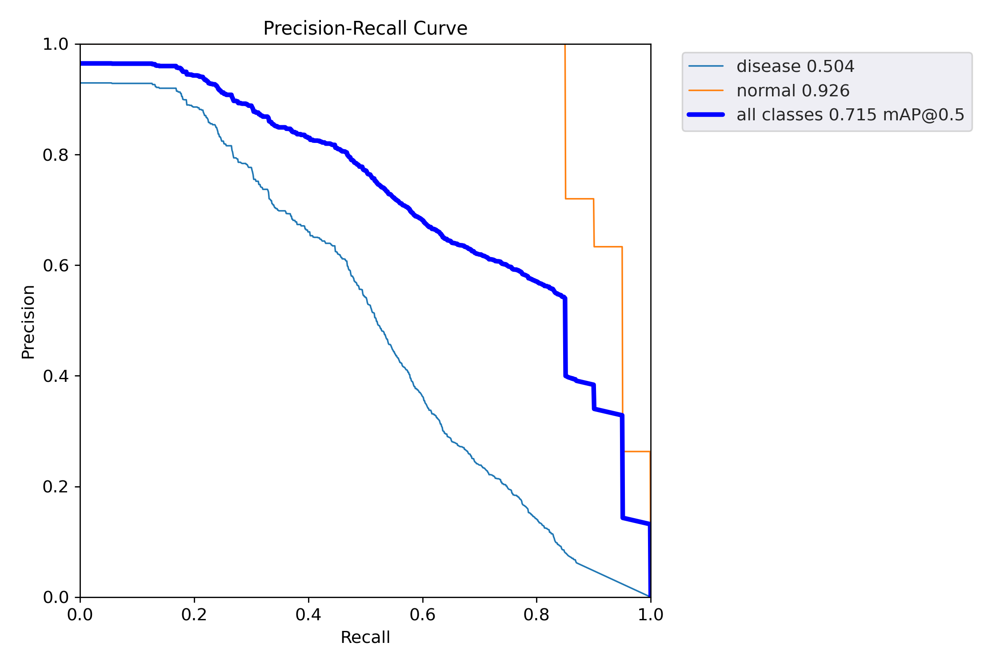

In [26]:
from IPython.display import Image, display
display(Image('/content/yolov5/runs/train/exp/PR_curve.png'))

The precision-recall curve is a graphical representation of the relationship between precision and recall. Based on these mAP scores, we can conclude that the model is performing well for the "normal" class (0.926 mAP) but not as well for the "disease" class (0.504 mAP). The overall performance of the model, as indicated by the mAP for all classes (0.715), is considered to be fair.

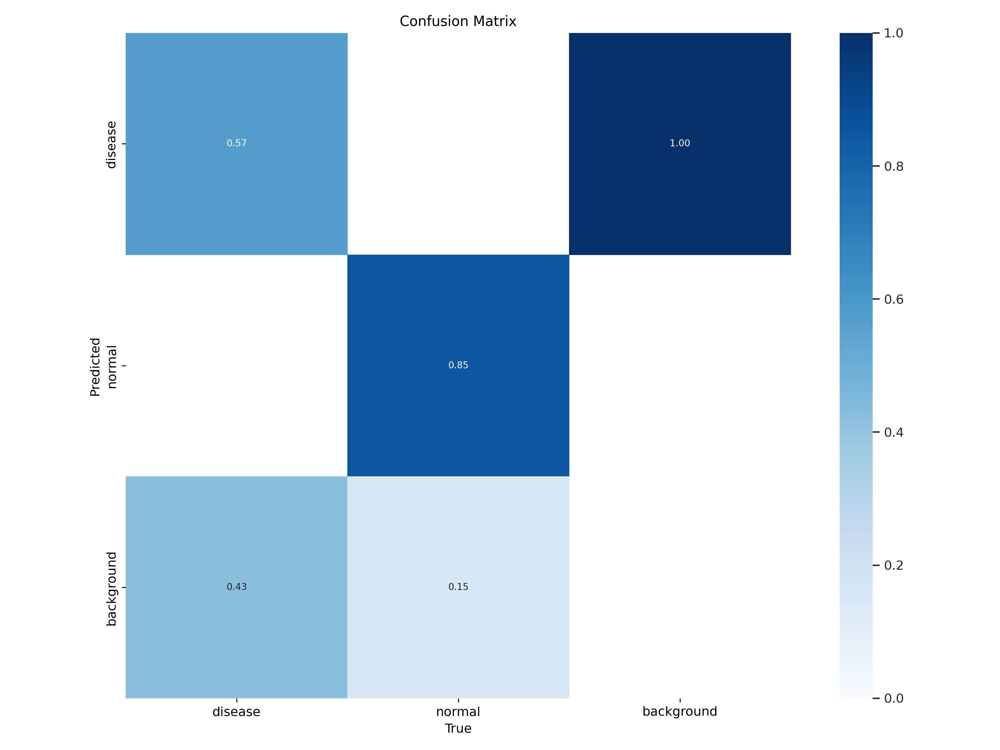

In [29]:
from IPython.display import Image, display
display(Image('/content/yolov5/runs/train/exp/confusion_matrix.png'))

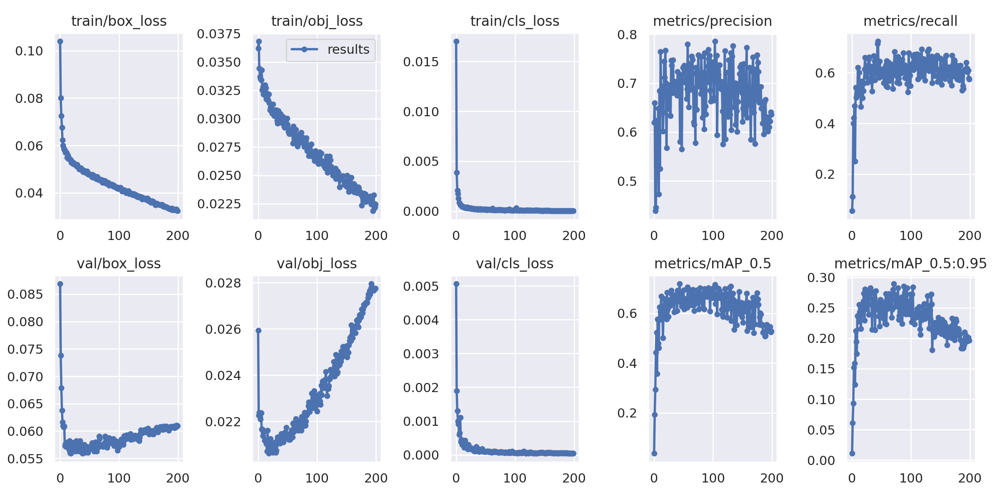

In [30]:
from IPython.display import Image, display
display(Image('/content/yolov5/runs/train/exp/results.png'))

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

**Results**

This model was able to accurately identify objects with an average precision of 0.786, which means that when the model makes a prediction, it is correct 78.6% of the time. The recall of 0.664 means that the model was able to correctly identify 66.4% of all the objects present in the images. The mean average precision of 0.715 represents the overall accuracy of the model in identifying objects.
There were two classes of objects the model was trained to identify: "disease" and "normal." The model performed better in identifying "normal" objects with an average precision of 0.992 and recall of 0.85. However, the model struggled more with identifying "disease" objects, with an average precision of 0.579 and recall of 0.478.
The mAP50-95 metric measures the model's accuracy for predictions with higher confidence levels. The data shows that the model's accuracy drops for predictions with higher confidence levels, with values of 0.284 for "all" classes and 0.186 for "disease" class. This means that the model is less accurate in its predictions with higher confidence levels.

Implications for rice disease management: The results of the training process can inform the development of new strategies and techniques for disease detection and management, helping to improve crop health and reduce the impact of diseases on food production and food security.

**Discussion**

Improving the quality of training data is a crucial step in improving the performance of a machine learning model.Collecting more real-world data can increase the size and diversity of the training data, which can help the model learn to make more accurate predictions.Data augmentation techniques can artificially increase the size of the training data by transforming and augmenting the existing data.Generating synthetic data can also increase the size of the training data, especially in cases where real-world data is scarce or difficult to obtain. Synthetic data can be generated using simulations or artificially generated data that resembles real-world data. However, it's important to make sure that the synthetic data accurately represents the real-world distribution and variability of the data to avoid overfitting or poor generalization to real-world data.
In conclusion, improving the model's performance is a multi-faceted challenge that requires careful consideration of the data and various techniques to optimize performance.

**Literature citation**

1.Bochkovskiy, A. (2020). YOLOv5: Real-Time Object Detection. GitHub repository. https://github.com/ultralytics/yolov5
2. Roboflow. (n.d.). Roboflow - Easy and Scalable Computer Vision Annotation. https://roboflow.com/
3. Google Colab. (n.d.). Google Colab - Research at Google. https://colab.research.google.com/

